## A/C/G T/NK Cells

Here I try to phenotype the T cell and NK subsets present in the leiden clusters marked by the TNF-Alpha, Control, and IFN-Gamma conditions.

In [1]:
import scanpy as sc
import pandas as pd 
import numpy as np
import matplotlib.pyplot as plt
from tqdm.notebook import tqdm
import warnings
import itertools as it
import json
import requests
import seaborn as sns
import pickle as pkl
from functools import reduce

/home/ssm-user/anaconda3/envs/codec/lib/python3.6/site-packages/anndata/core/anndata.py:17: FutureWarning: pandas.core.index is deprecated and will be removed in a future version.  The public classes are available in the top-level namespace.
  from pandas.core.index import RangeIndex
/home/ssm-user/anaconda3/envs/codec/lib/python3.6/site-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


In [2]:
sc.settings.verbosity = 4
sc.settings.set_figure_params(dpi=80)
print(sc.__version__)
sc.settings.n_jobs=12

1.4.5.post1


In [3]:
prefix = '/data/codec/production.run/'

### Load in Data

In [4]:
path = prefix + 'pkls/cts/combat/tnk.pkl'
    
with open(path,'rb') as file:
    tnk = pkl.load(file)

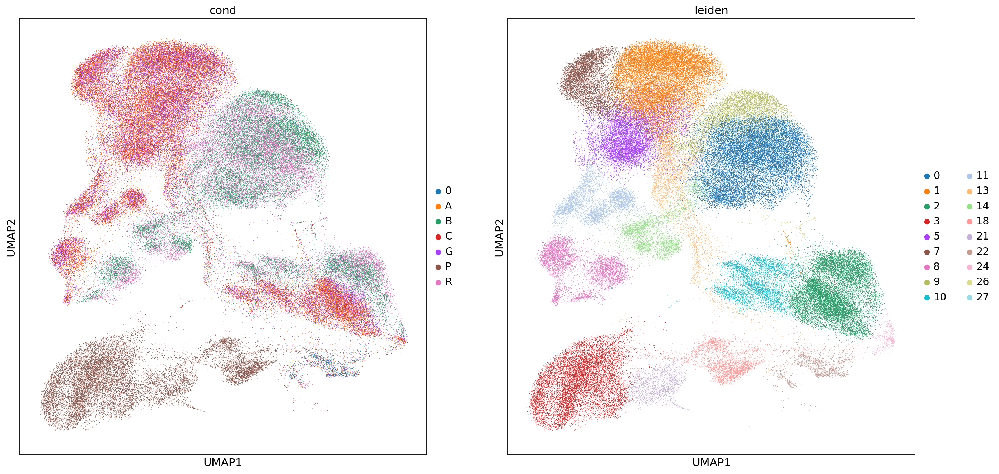

In [5]:
fig, ax = plt.subplots(1, 2, figsize=(20,10))
for color, ax in zip(['cond', 'leiden'], ax):
    sc.pl.umap(tnk['adata'],color=color, ax=ax, show=False, return_fig=False, size=2)

There is obviously a very prominent effect of the adjuvants on the this group of cells. One of the main concerns, however, is that the big population in the middle (leiden clusters 2 and 9) is marked by a higher percentage of mitochondrial transcripts.

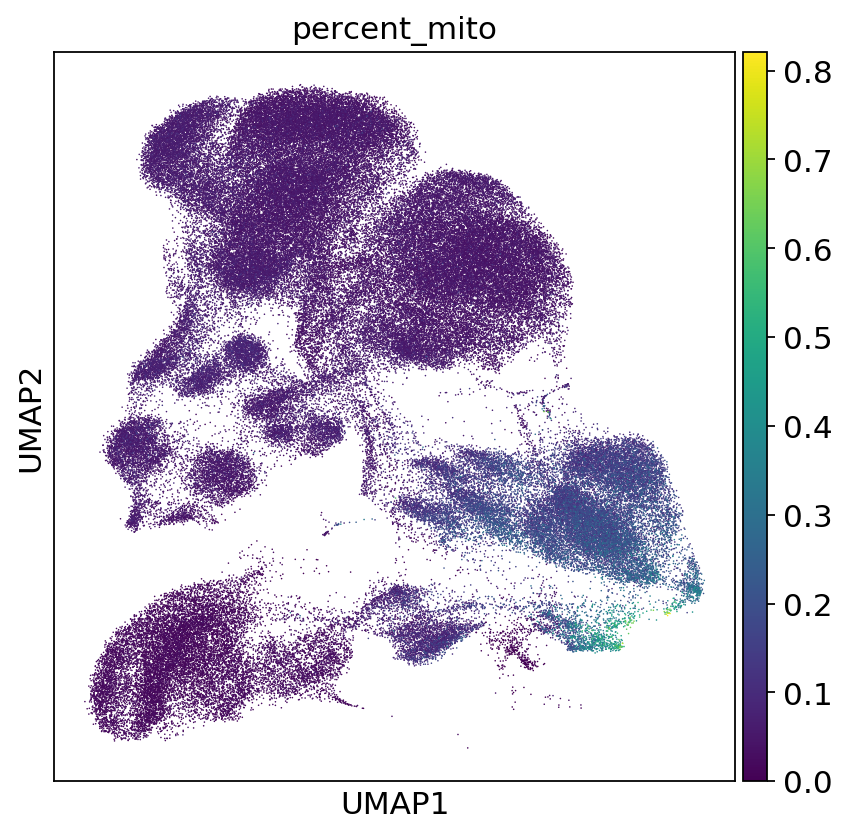

In [6]:
fig, ax = plt.subplots(1, 1, figsize=(6,6))
sc.pl.umap(tnk['adata'],color='percent_mito', ax=ax, show=False, return_fig=False, size=2);

We are _hoping_ that this is not due to the cells dying, and hopefully just some effect of the adjuvants, though seems unlikely. A few points to make:
1. Leiden cluster 13 seems to be acting as a bridge to the main populations, so perhaps those are dying cells. My bet is that if we were to visualize the 3rd UMAP dimension, these cells would be traveling through the Z axis into a differnt plane, because they seem to cut right though the right-side subpopulations of leiden cluster 5.  
2. I'm almost positive if I try to just do differential expression between the high mito population and the rest of the cells, it's only going to be mitochondrial transcripts. Despite this, there is still some heterogenity in this mito population, which could correspond to the normal low-mito populations.

I'll first try to just phenotype the main pops and the high mito pops separately, and then see if there is a 1-1 correspondence and that the only thing separating the high mito cells is just the mitochondrial transcripts, and maybe the activation of some apoptotic programs. Then we can start thinking about how to deal with them.

Cluster with a little higher resolution...

In [7]:
sc.tl.leiden(tnk['adata'],resolution=1)

running Leiden clustering
    finished: found 26 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:02:44)


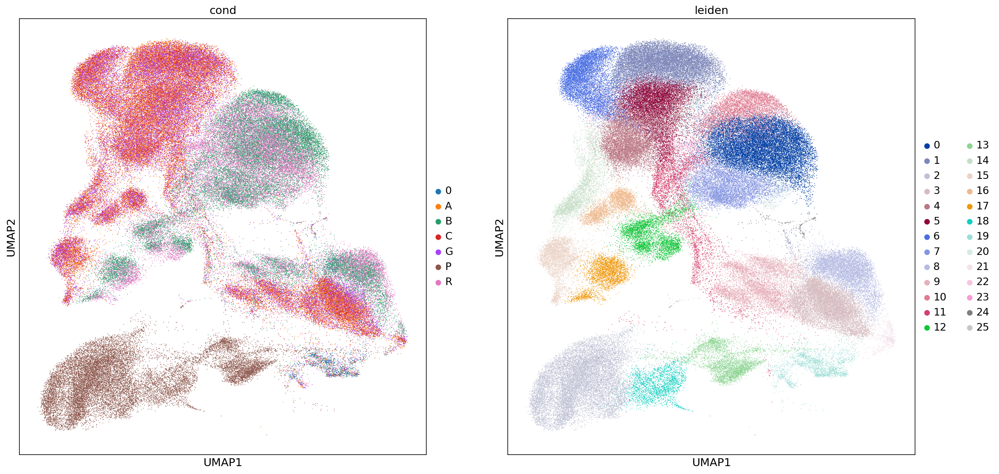

In [11]:
fig, ax = plt.subplots(1, 2, figsize=(20,10))
for color, ax in zip(['cond', 'leiden'], ax):
    sc.pl.umap(tnk['adata'],color=color, ax=ax, show=False, return_fig=False, size=3)

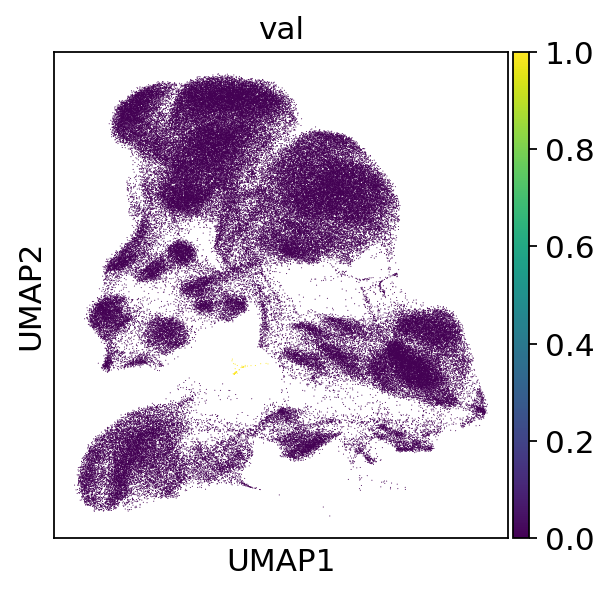

In [27]:
val = '25'
tnk['adata'].obs['val'] = tnk['adata'].obs['leiden'] == val
fig, ax = plt.subplots(1,1)
sc.pl.umap(tnk['adata'],color='val', ax=ax)
ax.set_facecolor('gray')
tnk['adata'].obs.drop(columns='val', inplace=True)

In [28]:
acg_lo_mito = [1, 4, 5, 6, 14, 15, 16, 23]
br_lo_mito = [0, 7, 10, 12, 17, 20, 22]
p_all = [2, 13, 18]
hi_mito = [3, 8, 9, 21]
other = [11, 19, 24, 25]

In [32]:
ctdict = dict()
ctdict['acg_lo'] = acg_lo_mito
ctdict['br_lo'] = br_lo_mito
ctdict['p_all'] = p_all
ctdict['hi_m'] = hi_mito
ctdict['other'] = other
tnk['adata'].obs['ct2'] = tnk['adata'].obs['leiden']
for ct in ctdict:
    for clust in ctdict[ct]:
        tnk['adata'].obs['ct2'].replace(str(clust), ct, inplace=True) 
tnk['adata'].obs['ct2'] = tnk['adata'].obs['ct2'].astype('category')

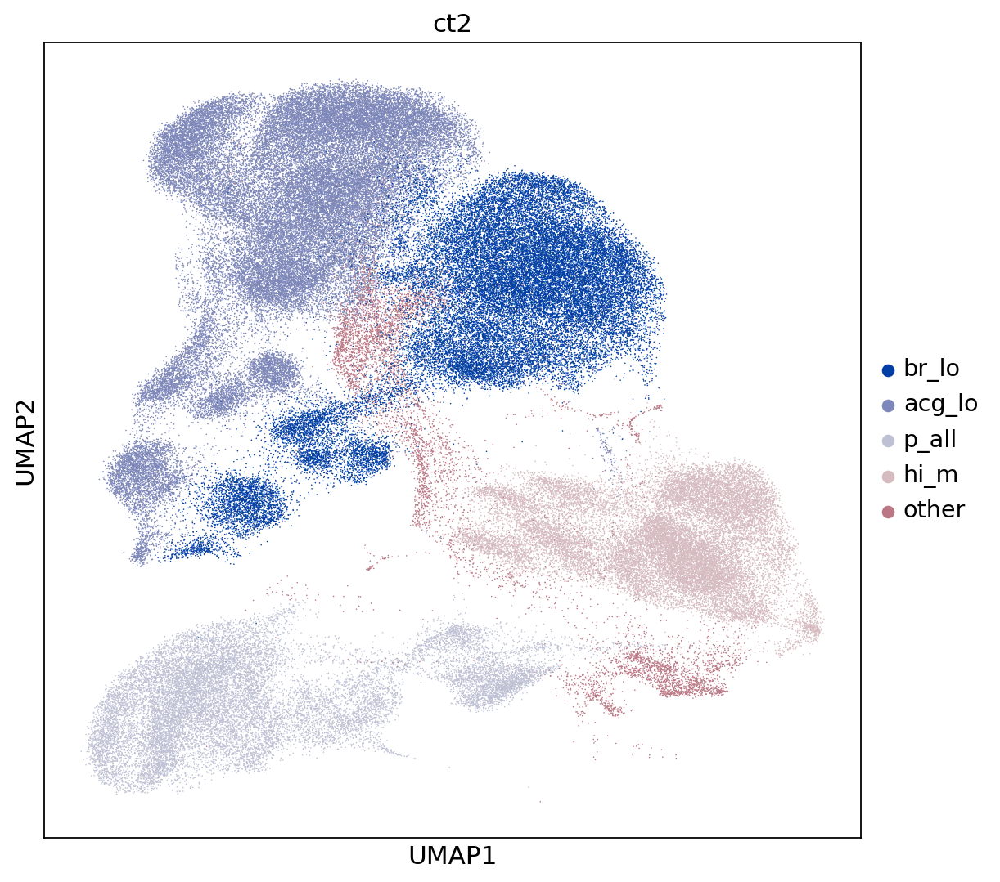

In [33]:
fig, ax = plt.subplots(1, 1, figsize=(8,8))
sc.pl.umap(tnk['adata'],color='ct2', ax=ax, show=False, return_fig=False, size=2);

### Extract Out Cell Barcodes

I want to take a look at the control and high mito populations in a separate notebook and see if I can adjust the data so that they cluster together.

In [36]:
path = prefix + 'mrna/obs/combat/acg.tnk.and.high.mito.bcs.txt'

with open(path,'w') as file:
    for bc in tnk['adata'][(tnk['adata'].obs['ct2'] == 'acg_lo') | 
                           (tnk['adata'].obs['ct2'] == 'hi_m')].obs_names:
        file.write(bc + '\n')

### A/C/G, Low Mito

Lets start from the top left. Clusters marked by cells stimulated with TNF-alpha and IFN-gamma, which have very nice overlap with our Control cells, indicating probably no major effect on these populations.

In [37]:
acg = tnk['adata'][tnk['adata'].obs['ct2'] == 'acg_lo'].copy()

# choosing to use true raw counts here - if I don't end up getting a bunch of house keeping genes coming as differentially expressed, not ideal
# acg.raw = tnk['raw'][tnk['adata'].obs['ct2'] == 'acg_lo'].copy()
# acg.raw = sc.pp.log1p(sc.pp.normalize_per_cell(tnk['raw'][tnk['adata'].obs['ct2'] == 'acg_lo'], copy=True), copy=True)

In [38]:
def acg_umap(acg, color, ax='None', **kwargs):
    if ax == 'None':
        fig, ax = plt.subplots(1, 1, figsize=(8,8))
    sc.pl.umap(acg,color=color, ax=ax, show=False, return_fig=False, size=4, use_raw=False, **kwargs);
    xlim = ax.get_xlim()
    ylim = ax.get_ylim()
    ax.set_xlim((xlim[0], 0))
    ax.set_ylim((-5, ylim[1]));
    return

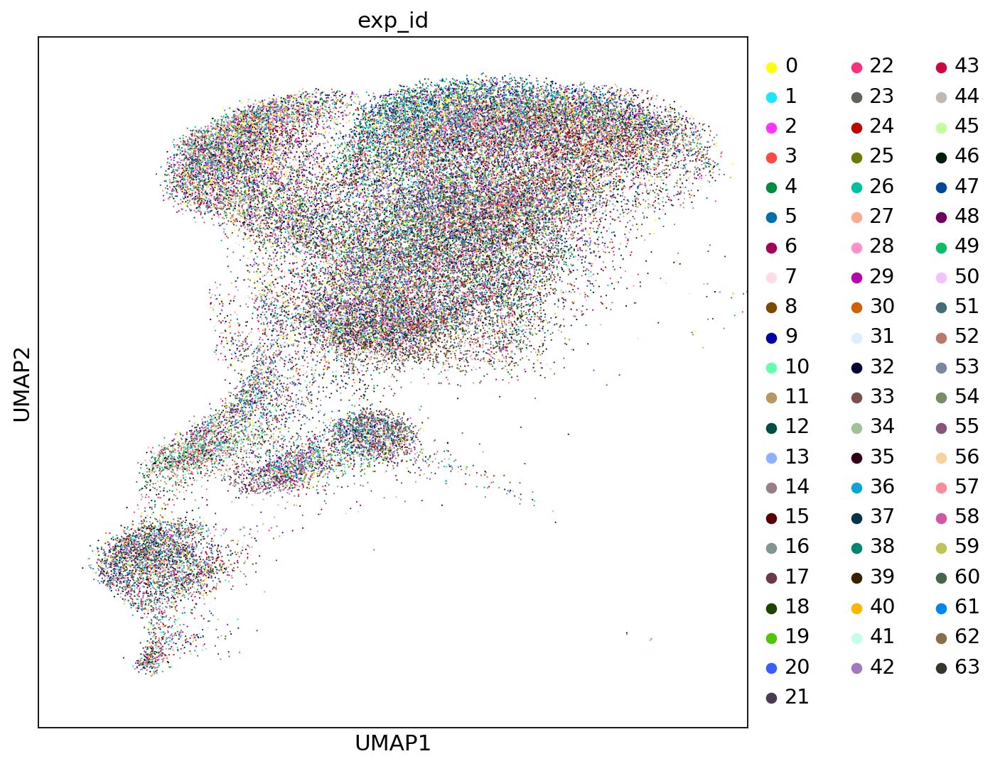

In [39]:
acg_umap(acg,'exp_id')

In [97]:
sc.tl.leiden(acg,resolution=0.5)

running Leiden clustering
    finished: found 9 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:21)


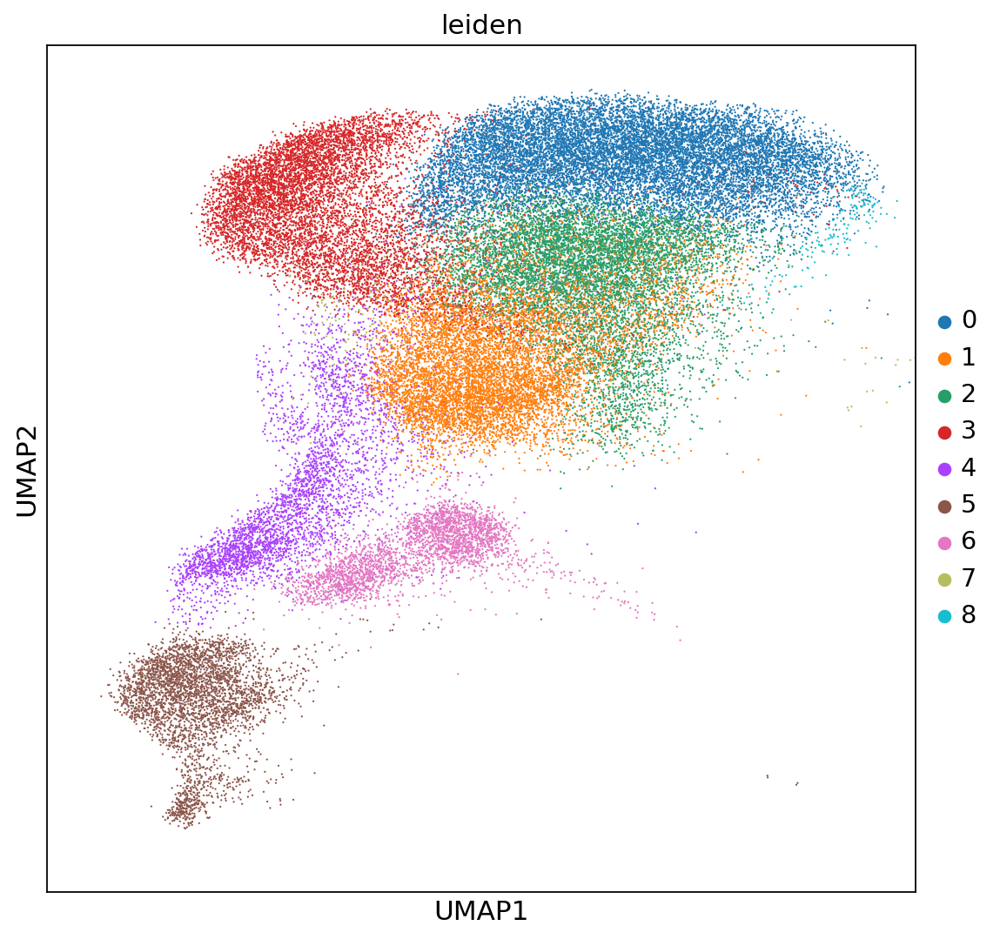

In [98]:
acg_umap(acg,color='leiden')

In [46]:
sub_acgs = dict() # put the new subsetted acg objects in a dictionary of acgs

In [101]:
sub_acgs['5'] = acg[acg.obs['leiden'] == '5'].copy()
sub_acgs['6'] = acg[acg.obs['leiden'] == '6'].copy()

running Leiden clustering
    finished: found 3 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:03)


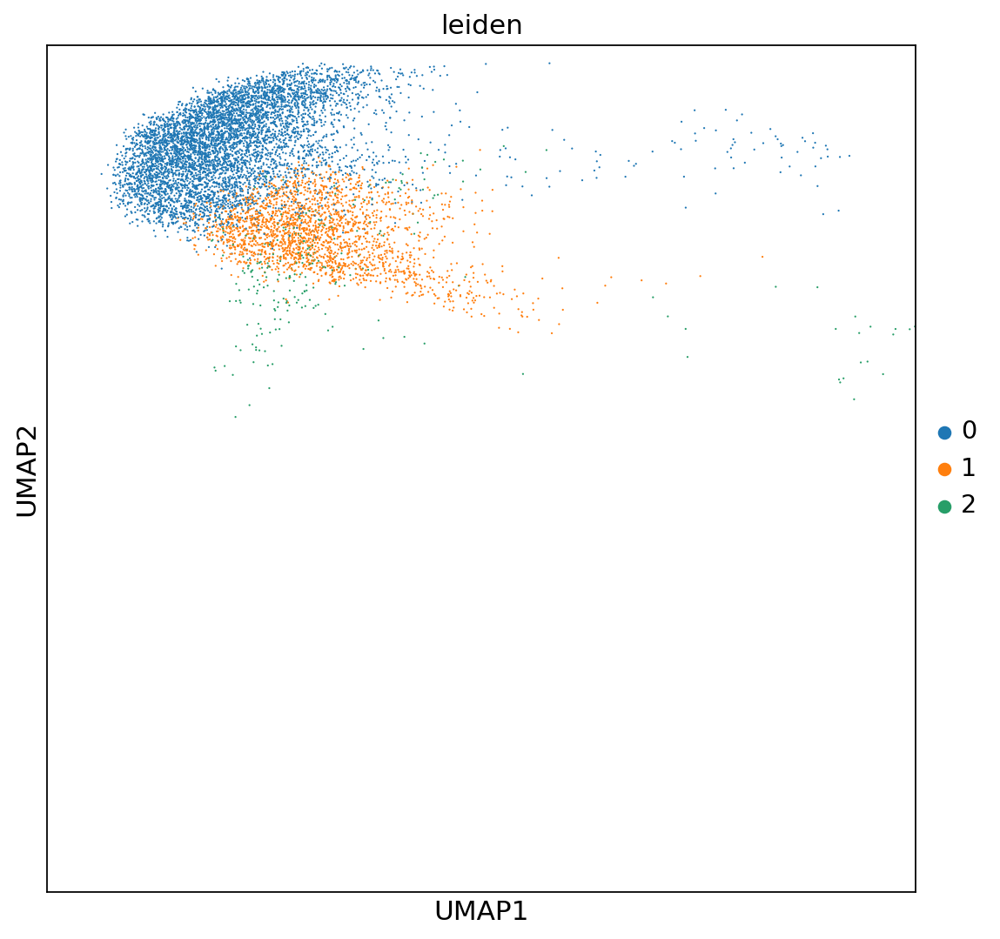

In [96]:
sc.tl.leiden(sub_acgs['3'], resolution=0.2) # subcluster them using Leiden
acg_umap(sub_acgs['3'],color='leiden')

running Leiden clustering
    finished: found 2 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


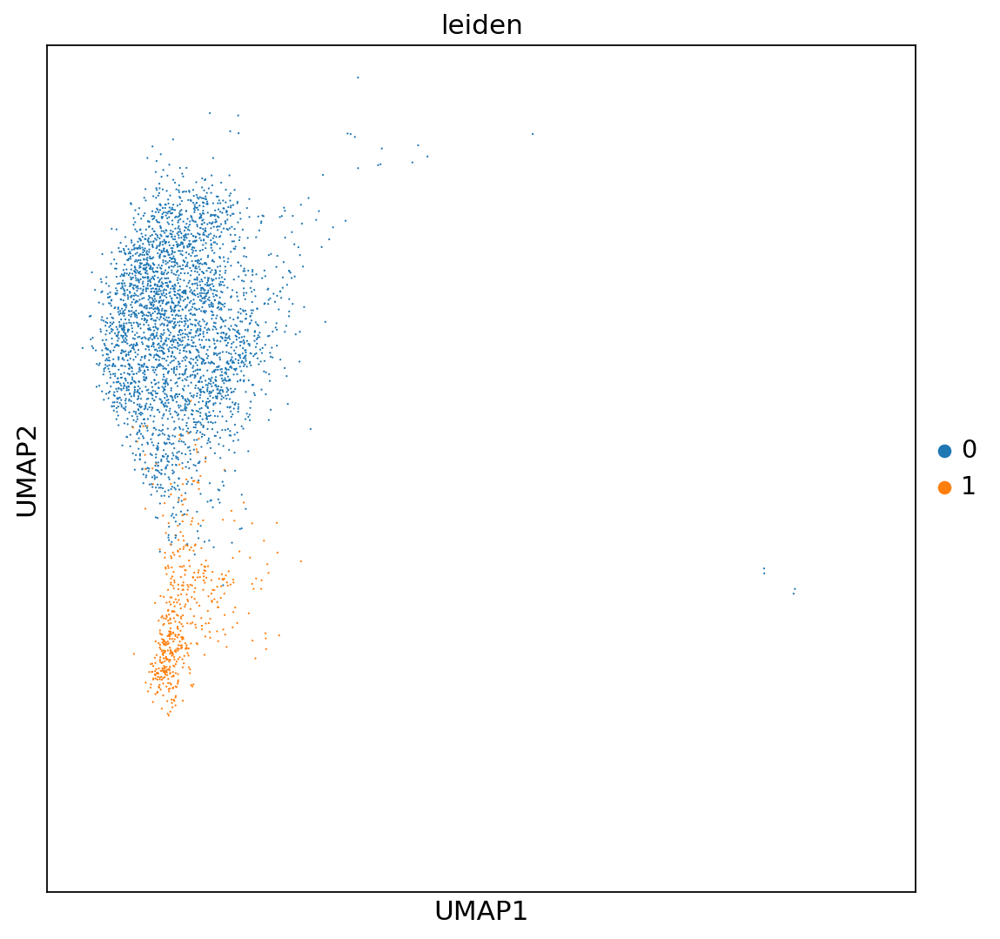

In [102]:
sc.tl.leiden(sub_acgs['5'], resolution=0.2) # subcluster them using Leiden
acg_umap(sub_acgs['5'],color='leiden')

running Leiden clustering
    finished: found 2 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


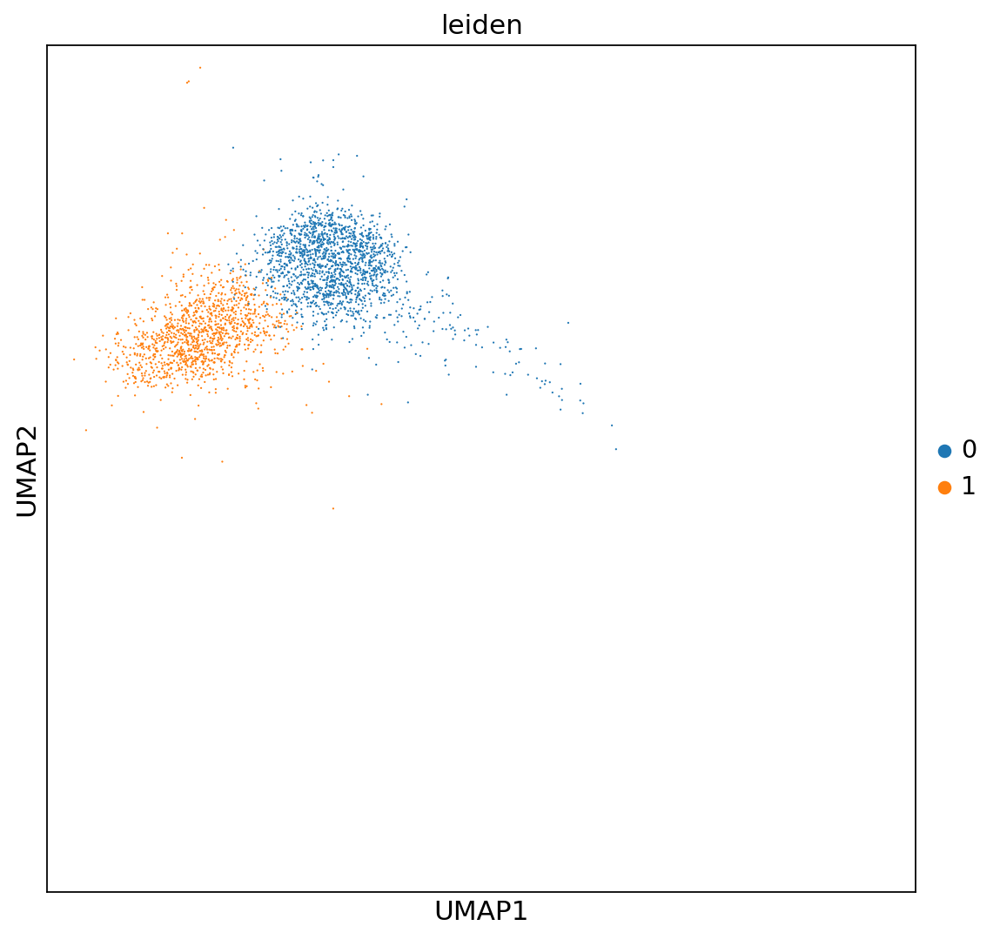

In [103]:
sc.tl.leiden(sub_acgs['6'], resolution=0.2) # subcluster them using Leiden
acg_umap(sub_acgs['6'],color='leiden')

In [201]:
ctdict = dict()
ctdict['ct0'] = [0]
ctdict['ct1'] = [1, 2]
sub_acgs['5'].obs['sub_ct'] = sub_acgs['5'].obs['leiden']
for ct in ctdict:
    for clust in ctdict[ct]:
        sub_acgs['5'].obs['sub_ct'].replace(r'^%s$' % str(clust), ct, regex=True, inplace=True)
sub_acgs['5'].obs['leiden'] = [i.strip('ct') for i in sub_acgs['5'].obs['sub_ct'].astype('category')]

... storing 'leiden' as categorical
... storing 'sub_ct' as categorical


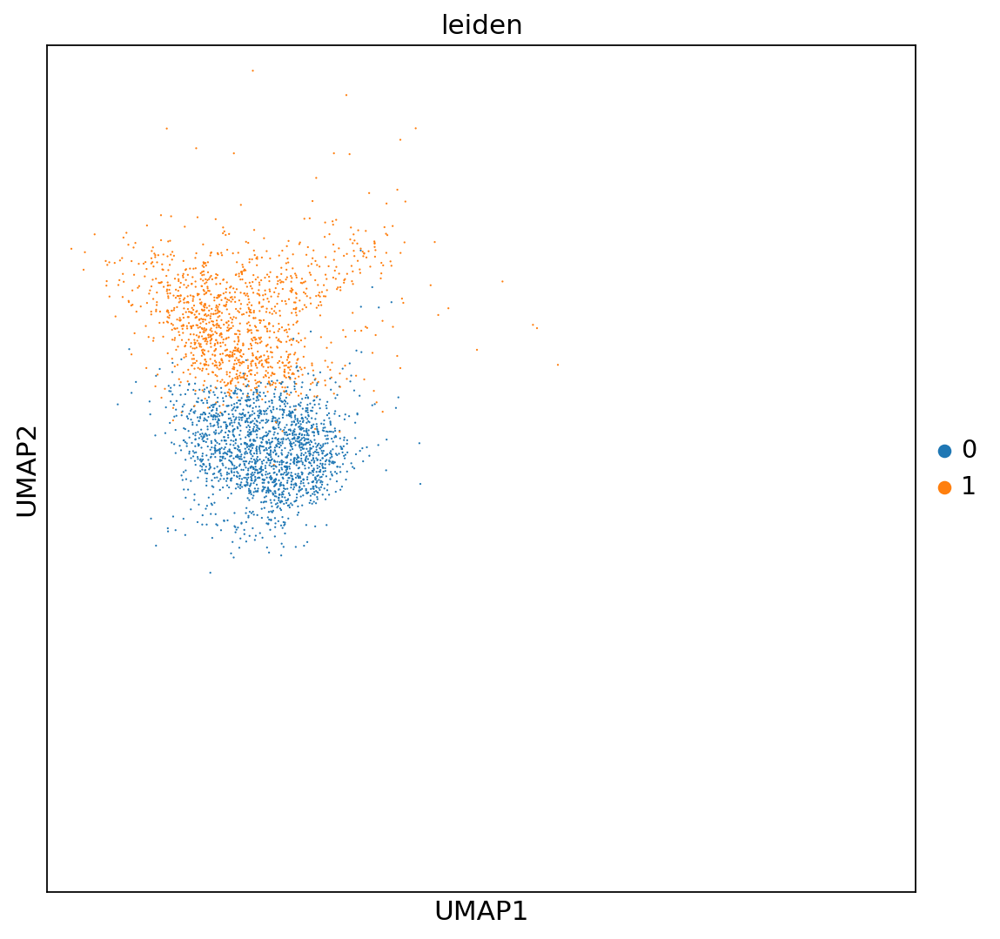

In [202]:
acg_umap(sub_acgs['5'],color='leiden')

running Leiden clustering
    finished: found 2 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:00:00)


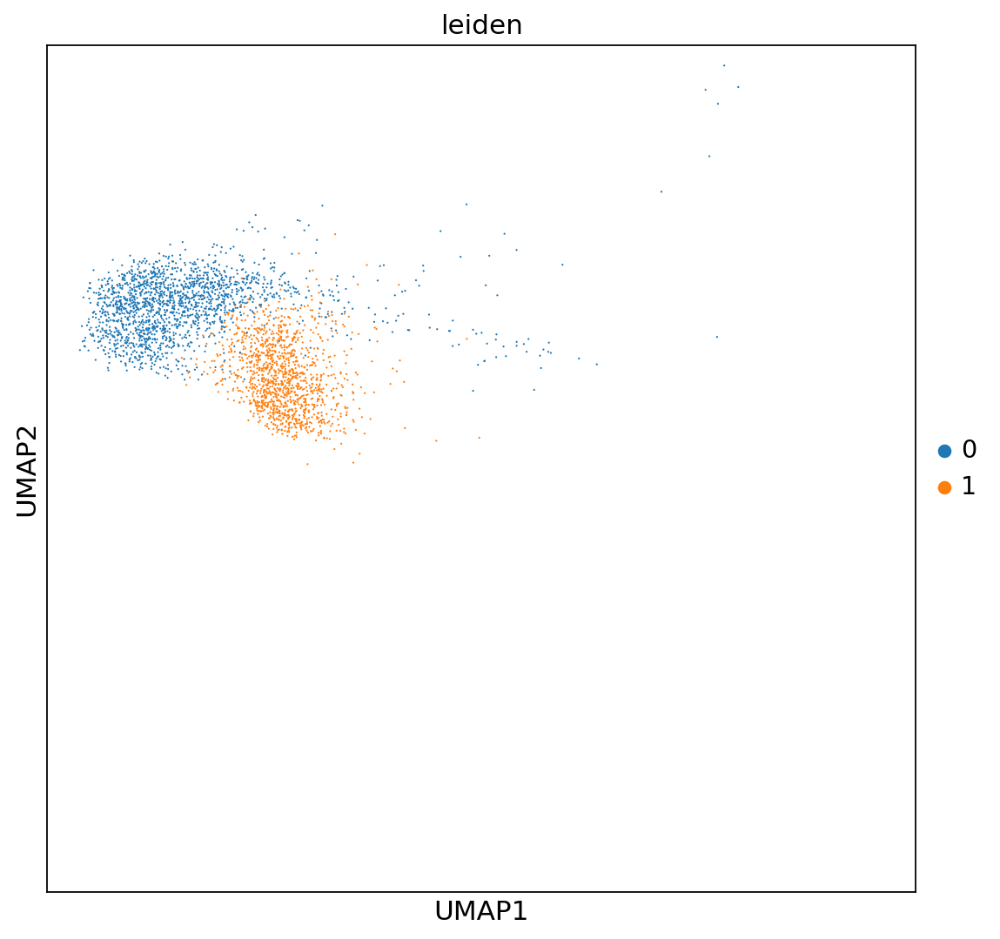

In [203]:
sc.tl.leiden(sub_acgs['6'], resolution=0.2) # subcluster them using Leiden
acg_umap(sub_acgs['6'],color='leiden')

In [104]:
def sub_cluster_mapper(adata, sub_adatas):
    '''
    This takes in the adata object and inserts a new leiden column in the `.obs`. 
    
    This function is really convoluted and there's probably a better, simpler way to do it,
    but it should theoretically work for any number of subclusters
    '''
    # ideally you'd make a copy of the adata object here, so we don't have to change the original
    # this would be in case we want to run it multiple times, perhaps the resolutions we put in didn't subset the clusters like we had hoped
    # and we need to run multiple times to adjust the resolution slightly
    
    # this block is to figure out that there are two new subclusters and they should be named 8, 9
    total_new_clusts = 0
    old_clusts = sub_adatas.keys()
    for sub_adata in sub_adatas:
        total_new_clusts += sub_adatas[sub_adata].obs['leiden'].astype(int).unique().max() + 1
    total_added_clusts = total_new_clusts - len(sub_adatas)
    new_clust_names_start = max(adata.obs['leiden'].astype(int))+1
    new_added_clust_names = [str(i) for i in range(new_clust_names_start,
                                                   new_clust_names_start + total_added_clusts)]
    
    # this block is to build a new list of leiden clusters from the old one 
    new_leiden = list()
    leiden_col = adata.obs['leiden'].copy()

    # this builds the new leiden cluster list, now adding a .1, .2, etc. to each new cluster
    for obs in leiden_col.index:
        clust_name = leiden_col.loc[obs]
        if clust_name not in old_clusts or sub_adatas[clust_name].obs.loc[obs, 'leiden'] == '0':
            new_leiden.append(clust_name)
        else:
            new_leiden.append(clust_name + '.%s' % sub_adatas[clust_name].obs.loc[obs,'leiden'])

    # this renames the .1, .2, etc clusters to the new, better names I came up with above (8 and 9)
    new_leiden = pd.Series(new_leiden, index=adata.obs_names)
    added_clusts = np.setdiff1d(new_leiden,adata.obs['leiden'])
    new_leiden.replace(dict(zip(added_clusts, new_added_clust_names)), inplace=True)
    
    # replace the old leiden column, must do these steps sequentially 
    adata.obs['leiden'] = new_leiden.astype(int) # to order the clusters by number
    adata.obs['leiden'] = new_leiden.astype(str) # to convert to string as normal
#     adata.obs['leiden'] = new_leiden.astype('category') # don't do this, it messes things up, just let scanpy do it as it plots
    return adata

In [105]:
acg = sub_cluster_mapper(acg, sub_acgs)

In [ ]:
acg.obs.drop(columns=['sub_ct'], inplace=True)

... storing 'leiden' as categorical


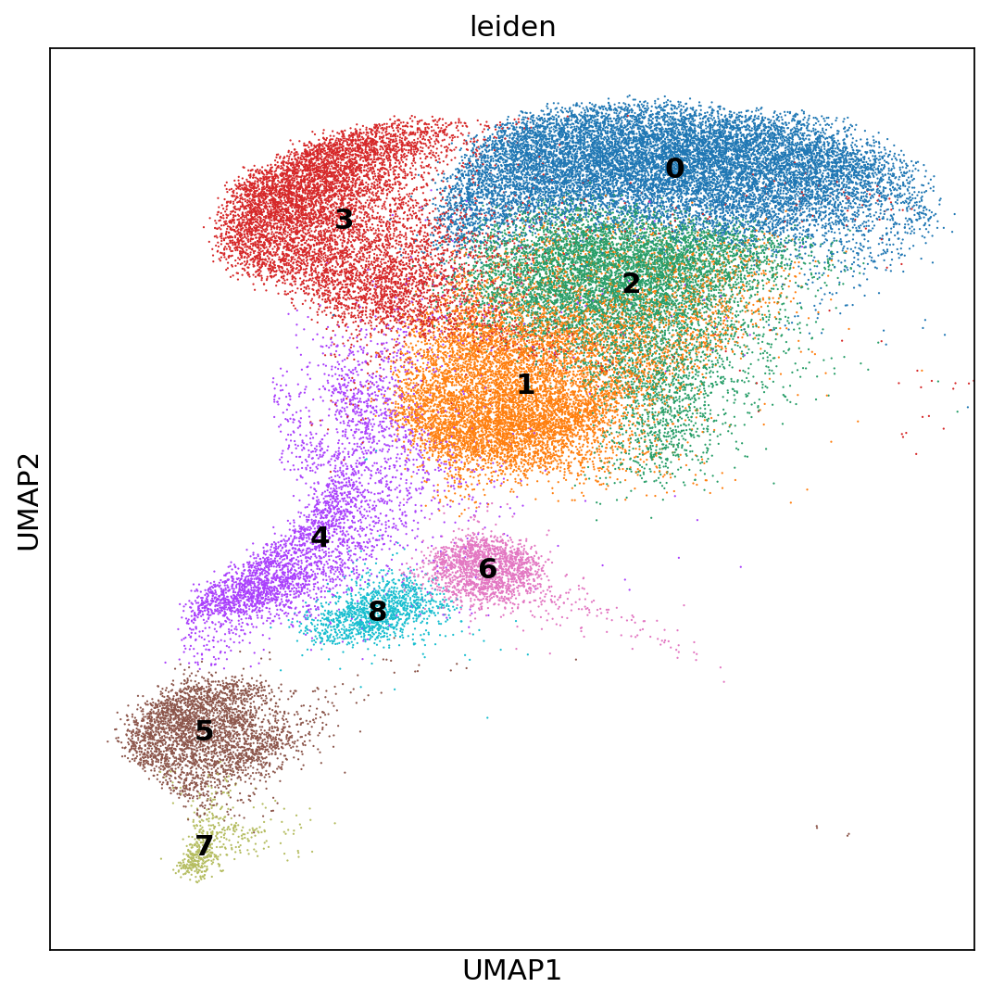

In [107]:
acg_umap(acg,color='leiden', legend_loc='on data', palette=sc.pl.palettes.vega_20_scanpy)

In [108]:
all_features = acg.var_names.tolist() + [i for i in acg.obs.columns if '|' in i]

In [109]:
def check_names(list_of_strings):
    if type(list_of_strings) != list:
        raise
    for f in all_features:
        for j in list_of_strings:
            if j in f:
                print(f)
    return

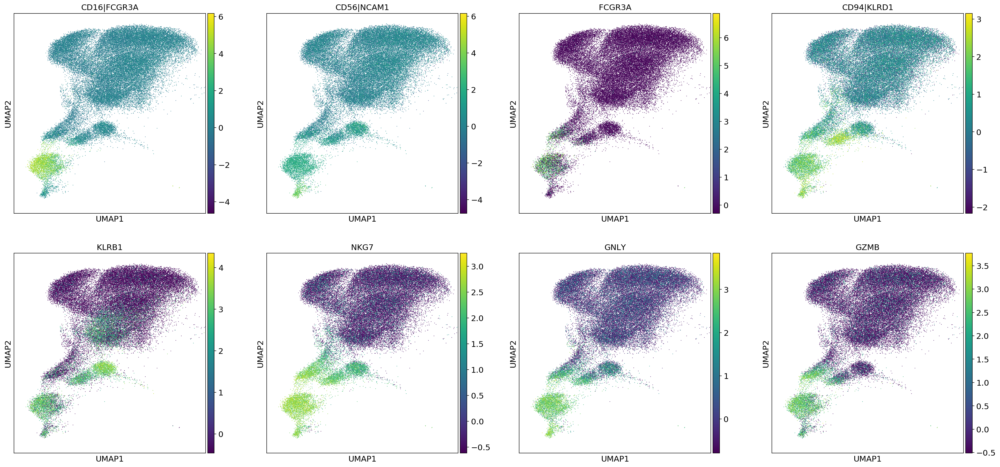

In [110]:
features = ['CD16|FCGR3A', 'CD56|NCAM1', 'FCGR3A', 'CD94|KLRD1', 'KLRB1', 'NKG7', 'GNLY', 'GZMB']
fig, ax = plt.subplots(2, 4, figsize=(30,14))
for f, ax in tqdm(zip(features, np.ravel(ax))):
    acg_umap(acg,color=f, ax=ax)

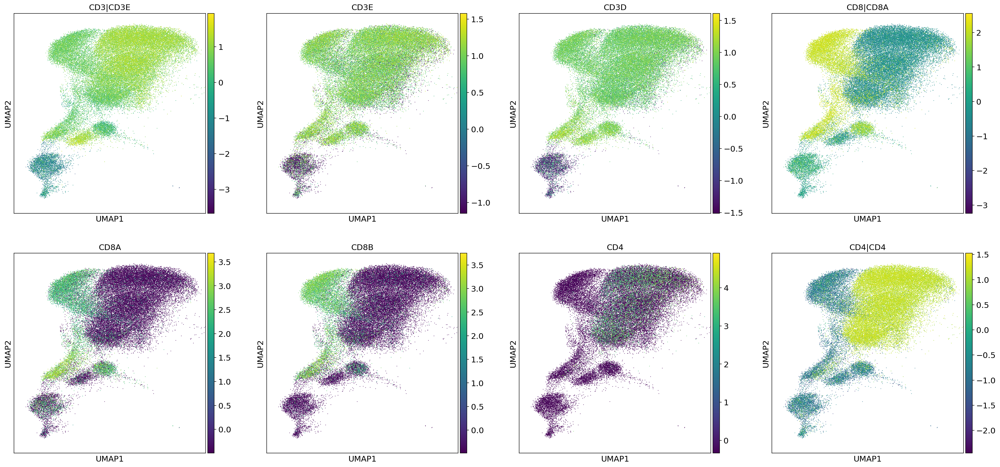

In [111]:
features = ['CD3|CD3E', 'CD3E', 'CD3D', 'CD8|CD8A', 'CD8A', 'CD8B', 'CD4', 'CD4|CD4']
fig, ax = plt.subplots(2, 4, figsize=(30,14))
for f, ax in tqdm(zip(features, np.ravel(ax))):
    acg_umap(acg,color=f, ax=ax)

In [112]:
acg_sub_cts = ['cd8', 'cd4', 'cd3dn', 'nk']

In [115]:
ctdict = dict()
ctdict['cd8'] = [3, 4, 6]
ctdict['cd4'] = [0, 1, 2]
ctdict['cd3dn'] = [8]
ctdict['nk'] = [5, 7]
acg.obs['ct3'] = acg.obs['leiden']
for ct in ctdict:
    for clust in ctdict[ct]:
        acg.obs['ct3'].replace(str(clust), ct, regex=True, inplace=True)
acg.obs['ct3'] = acg.obs['ct3'].astype('category')

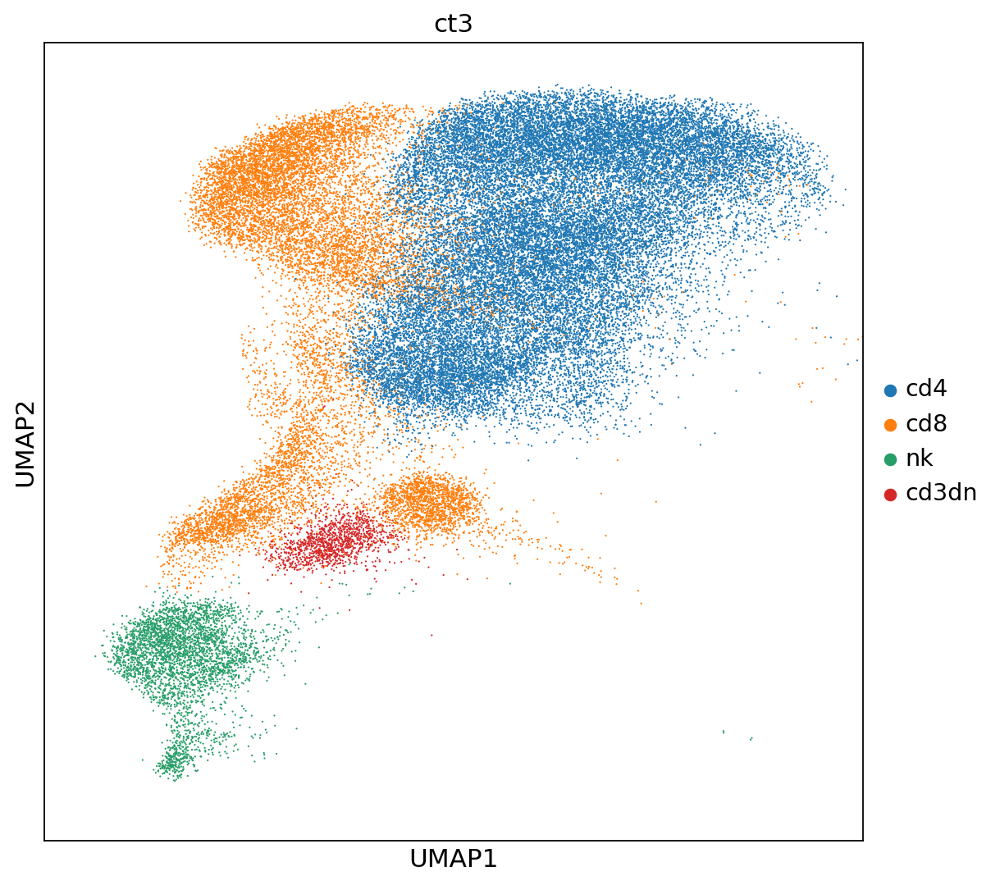

In [116]:
acg_umap(acg,color='ct3')

In [117]:
acg_subs = dict()
for ct in acg_sub_cts:
    acg_subs[ct] = acg[acg.obs['ct3'] == ct].copy()

### Phenotyping Subsets

Using [this paper](https://www.ncbi.nlm.nih.gov/pmc/articles/PMC4810120/) for reference for T cell subsets.

#### CD4

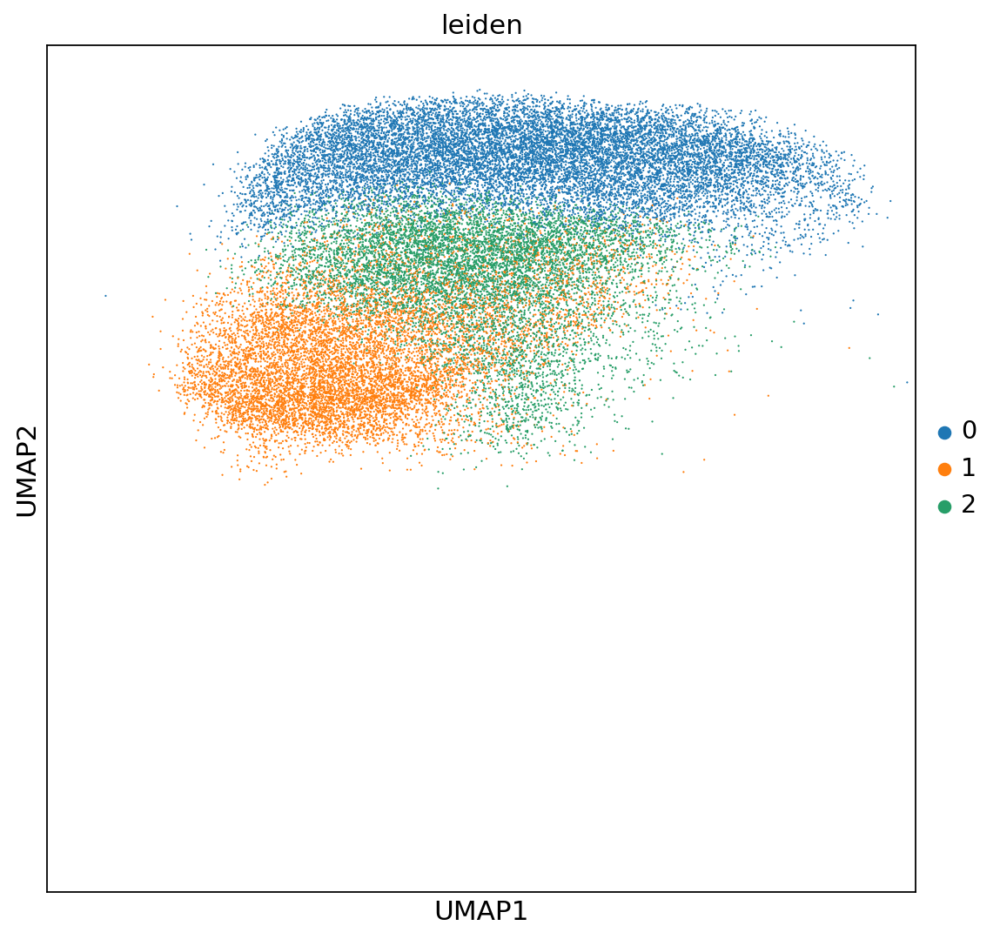

In [118]:
acg_umap(acg_subs['cd4'],color='leiden')

In [119]:
check_names(['CTLA'])

CTLA4
CD152|CTLA4


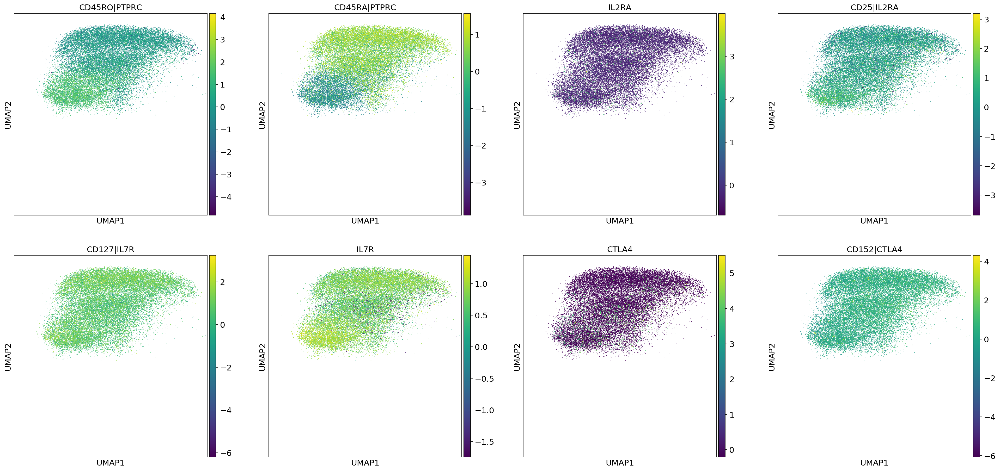

In [120]:
features = ['CD45RO|PTPRC', 'CD45RA|PTPRC', 'IL2RA', 'CD25|IL2RA', 'CD127|IL7R', 'IL7R', 'CTLA4', 'CD152|CTLA4']
fig, ax = plt.subplots(2, 4, figsize=(30,14))
for f, ax in tqdm(zip(features, np.ravel(ax))):
    acg_umap(acg_subs['cd4'], color=f, ax=ax)

In [121]:
focus_clusts = list(map(str,[0, 1, 2]))
clusts = acg_subs['cd4'].obs['leiden'].dtype.categories
clust_bool = [i in focus_clusts for i in clusts]
colors = np.array(acg_subs['cd4'].uns['leiden_colors'])

In [122]:
features = ['CD45RO|PTPRC', 'CD45RA|PTPRC', 'IL2RA', 'CD25|IL2RA', 'CD127|IL7R', 'IL7R', 'CTLA4', 'CD152|CTLA4', 'SELL', 'CD62L|SELL', 'CCR7', 'CD197|CCR7']
log_f = ['IL2RA', 'CTLA4']

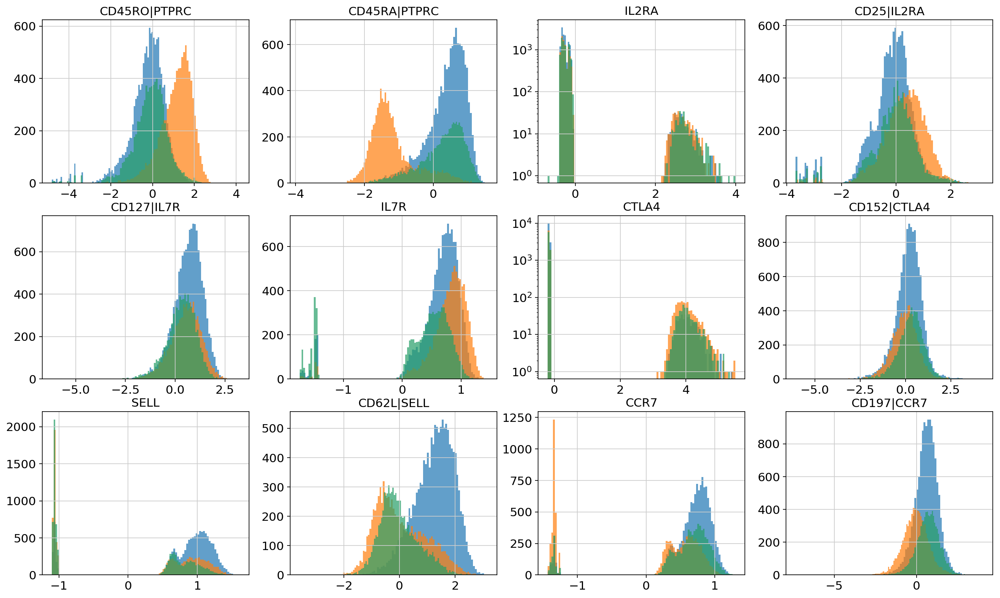

In [123]:
fig, ax = plt.subplots(3, 4, figsize=(20,12))
for f, ax in tqdm(zip(features, np.ravel(ax)), total=12):
    for clust, color in zip(focus_clusts, colors[clust_bool]):
        ax.hist(np.array(acg_subs['cd4'][acg_subs['cd4'].obs['leiden'] == clust].obs_vector(f)), # need the np.array wrapper because for the genes it returns an "Array View"
                color=color, bins=100, alpha=0.7)
        if f in log_f:
            ax.set_yscale('log')
    ax.set_title(f)

In [124]:
conds = acg_subs['cd4'].obs['cond'].dtype.categories

In [125]:
cond_leiden_df = pd.DataFrame(index=conds, columns=clusts, dtype=np.int)

In [126]:
for cond in tqdm(conds):
    for clust in clusts:
        cond_leiden_df.loc[cond, clust] = acg_subs['cd4'][(acg_subs['cd4'].obs['cond'] == cond) & 
                                                          (acg_subs['cd4'].obs['leiden'] == clust)
                                                         ].shape[0]

In [127]:
cond_leiden_df = cond_leiden_df.divide(cond_leiden_df.sum(0),1)

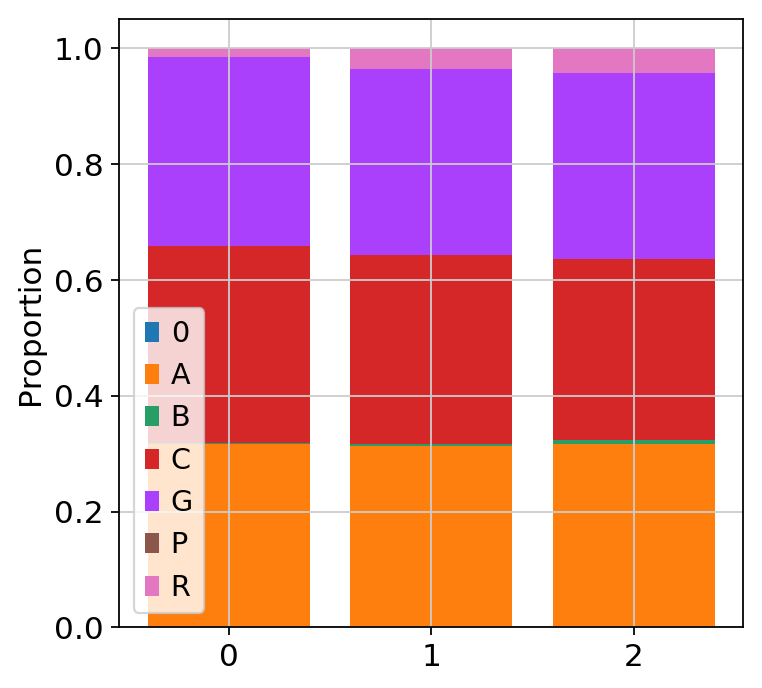

In [129]:
labels = clusts
props = dict()

for cond in conds:
    props[cond] = cond_leiden_df.loc[cond].values

fig, ax = plt.subplots(figsize=(5,5))
lastpos = [0]*len(clusts)
for cond in props:
    ax.bar(labels, props[cond], label=cond, bottom=lastpos)
    lastpos = props[cond] + lastpos

ax.set_ylabel('Proportion')
ax.legend()

plt.show()

In [132]:
ctdict = dict()
ctdict['Naive'] = [0]
ctdict['EffM'] = [1]
ctdict['Eff'] = [2]
acg_subs['cd4'].obs['ct4'] = acg_subs['cd4'].obs['leiden']
for ct in ctdict:
    for clust in ctdict[ct]:
        acg_subs['cd4'].obs['ct4'].replace(str(clust), ct, regex=True, inplace=True)
acg_subs['cd4'].obs['ct4'] = acg_subs['cd4'].obs['ct4'].astype('category')

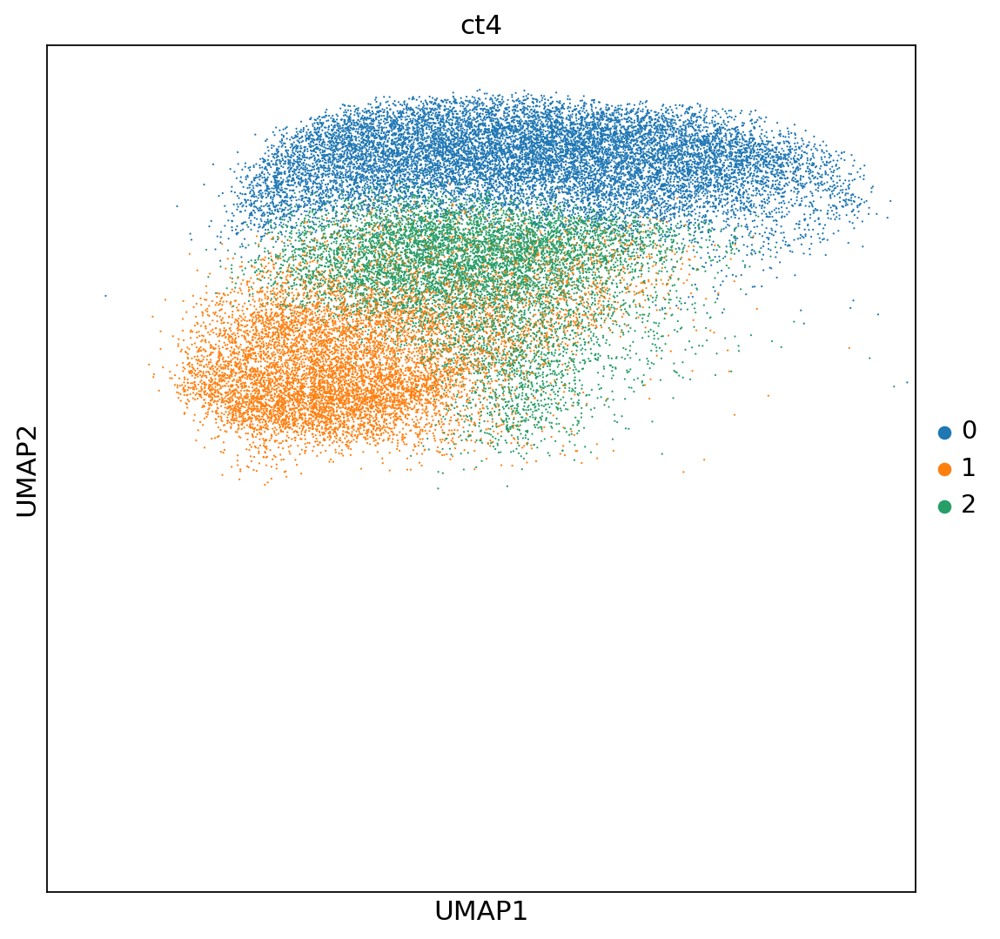

In [131]:
acg_umap(acg_subs['cd4'], color='ct4')

### CD8

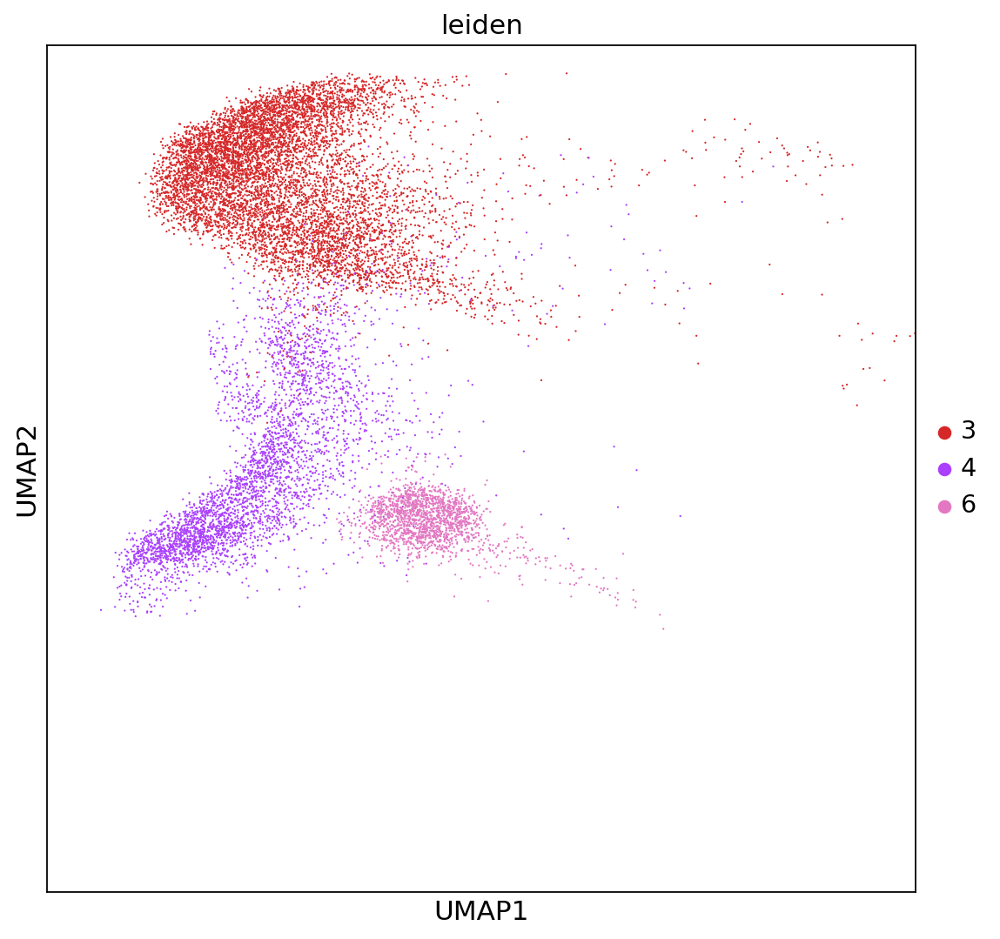

In [133]:
acg_umap(acg_subs['cd8'],color='leiden')

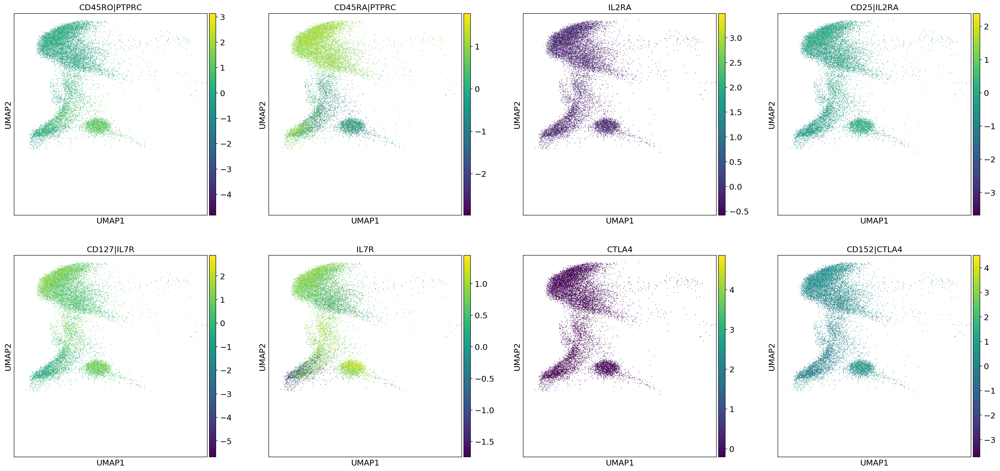

In [134]:
features = ['CD45RO|PTPRC', 'CD45RA|PTPRC', 'IL2RA', 'CD25|IL2RA', 'CD127|IL7R', 'IL7R', 'CTLA4', 'CD152|CTLA4']
fig, ax = plt.subplots(2, 4, figsize=(30,14))
for f, ax in tqdm(zip(features, np.ravel(ax))):
    acg_umap(acg_subs['cd8'], color=f, ax=ax)

In [135]:
focus_clusts = list(map(str,[3, 4, 6]))
clusts = acg_subs['cd8'].obs['leiden'].dtype.categories
clust_bool = [i in focus_clusts for i in clusts]
colors = np.array(acg_subs['cd8'].uns['leiden_colors'])

In [136]:
features = ['CD45RO|PTPRC', 'CD45RA|PTPRC', 'IL2RA', 'CD25|IL2RA', 'CD127|IL7R', 'IL7R', 'CTLA4', 'CD152|CTLA4', 'SELL', 'CD62L|SELL', 'CCR7', 'CD197|CCR7']
log_f = ['IL2RA', 'CTLA4', 'SELL', 'CCR7']

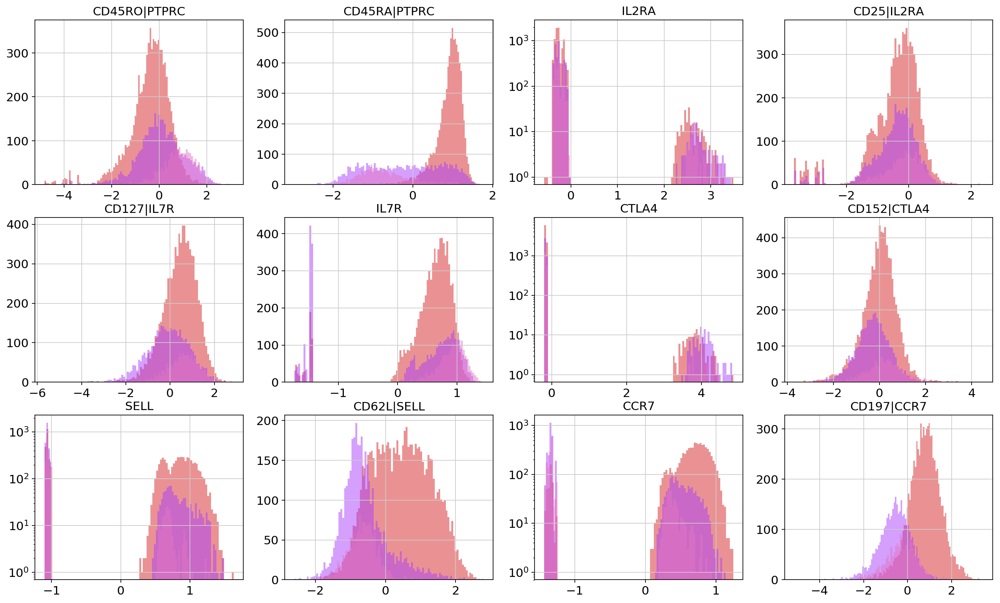

In [137]:
fig, ax = plt.subplots(3, 4, figsize=(20,12))
for f, ax in tqdm(zip(features, np.ravel(ax)), total=12):
    for clust, color in zip(focus_clusts, colors[clust_bool]):
        ax.hist(np.array(acg_subs['cd8'][acg_subs['cd8'].obs['leiden'] == clust].obs_vector(f)), # need the np.array wrapper because for the genes it returns an "Array View"
                color=color, bins=100, alpha=0.5)
        if f in log_f:
            ax.set_yscale('log')
    ax.set_title(f)

In [138]:
conds = acg_subs['cd8'].obs['cond'].dtype.categories

In [139]:
cond_leiden_df = pd.DataFrame(index=conds, columns=clusts, dtype=np.int)

In [140]:
for cond in tqdm(conds):
    for clust in clusts:
        cond_leiden_df.loc[cond, clust] = acg_subs['cd8'][(acg_subs['cd8'].obs['cond'] == cond) & (acg_subs['cd8'].obs['leiden'] == clust)].shape[0]

In [141]:
cond_leiden_df = cond_leiden_df.divide(cond_leiden_df.sum(0),1)

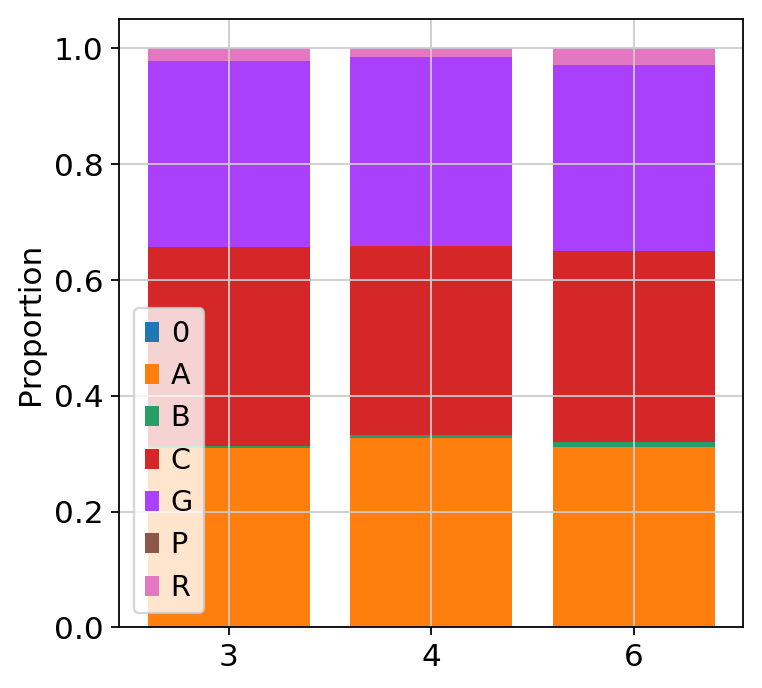

In [143]:
labels = clusts
props = dict()

for cond in conds:
    props[cond] = cond_leiden_df.loc[cond].values

fig, ax = plt.subplots(figsize=(5,5))
lastpos = [0]*len(clusts)
for cond in props:
    ax.bar(labels, props[cond], label=cond, bottom=lastpos)
    lastpos = props[cond] + lastpos

ax.set_ylabel('Proportion')
ax.legend()

plt.show()

In [147]:
ctdict = dict()
ctdict['Naive'] = [3]
ctdict['Mixed'] = [4]
ctdict['Eff_Mem'] = [6]
acg_subs['cd8'].obs['ct4'] = acg_subs['cd8'].obs['leiden']
for ct in ctdict:
    for clust in ctdict[ct]:
        acg_subs['cd8'].obs['ct4'].replace(str(clust), ct, regex=True, inplace=True)
acg_subs['cd8'].obs['ct4'] = acg_subs['cd8'].obs['ct4'].astype('category')

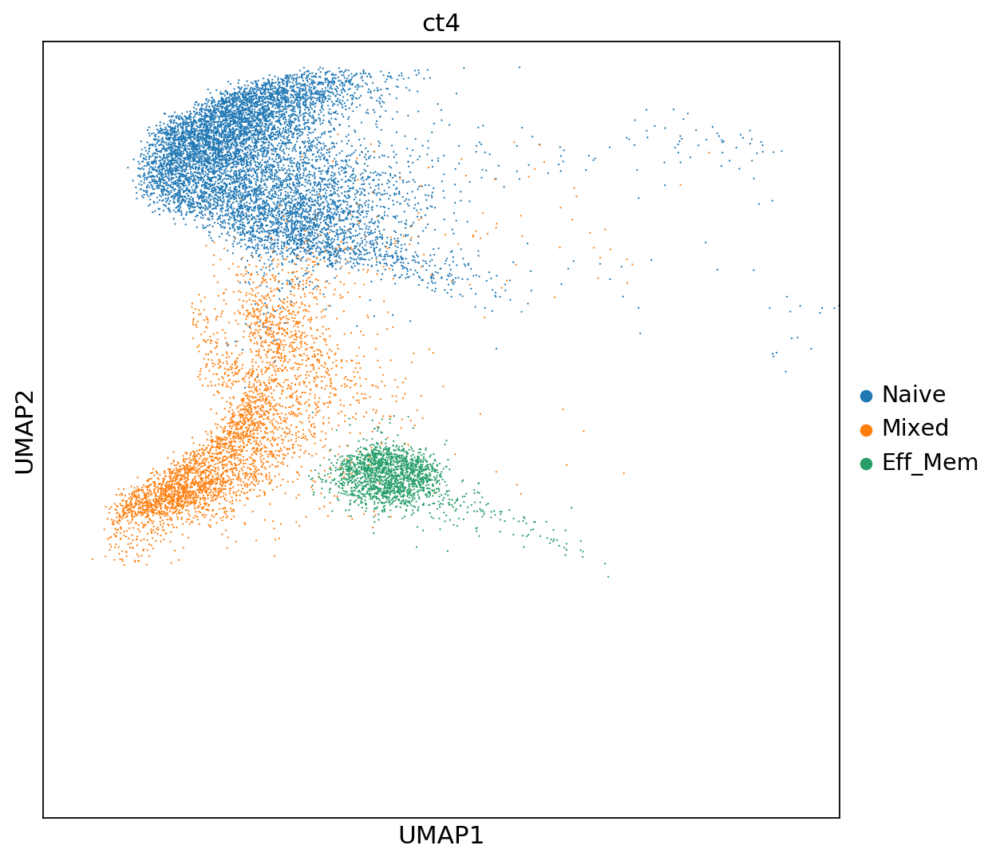

In [148]:
acg_umap(acg_subs['cd8'], color='ct4')

### NK

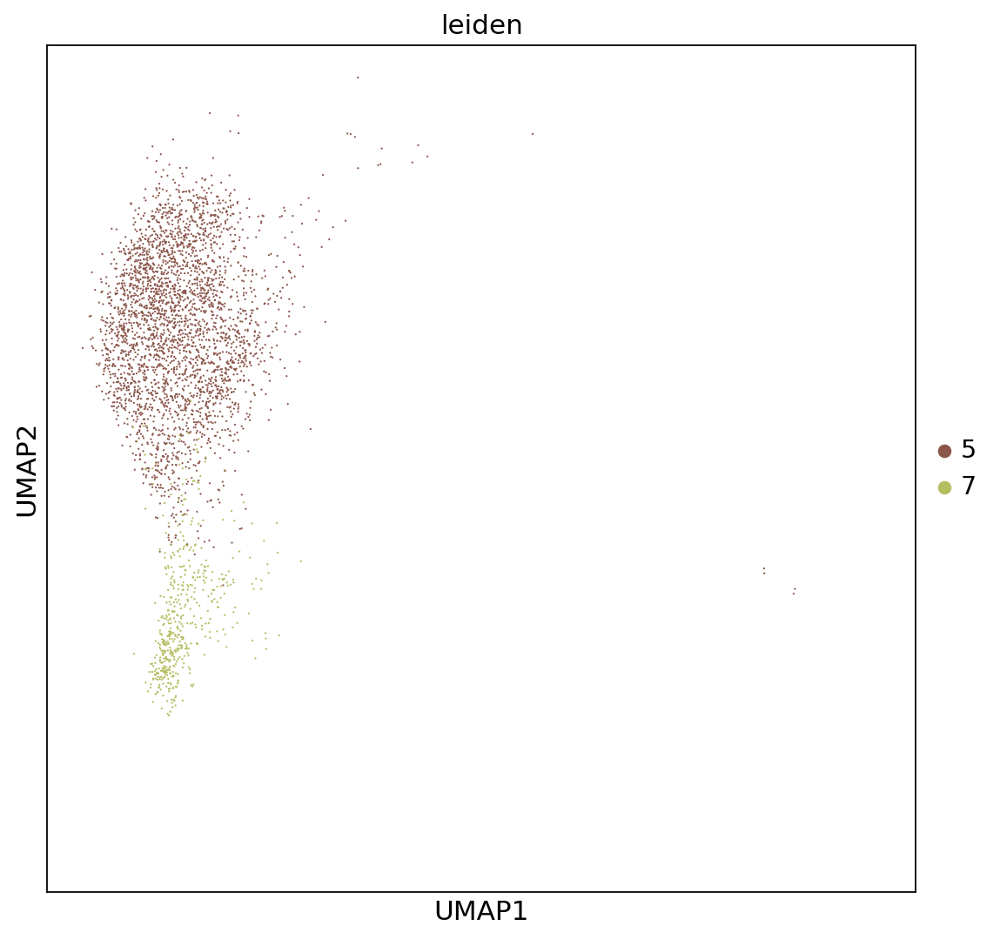

In [149]:
acg_umap(acg_subs['nk'], color='leiden')

In [150]:
focus_clusts = list(map(str,[5, 7]))
clusts = acg_subs['nk'].obs['leiden'].dtype.categories
clust_bool = [i in focus_clusts for i in clusts]
colors = np.array(acg_subs['nk'].uns['leiden_colors'])

In [151]:
features = ['FCGR3A', 'CD16|FCGR3A', 'NCAM1', 'CD56|NCAM1']
log_f = ['FCGR3A','NCAM1']

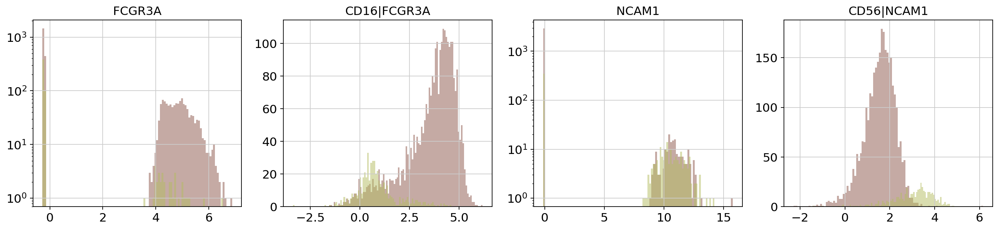

In [152]:
fig, ax = plt.subplots(1, 4, figsize=(20,4))
for f, ax in tqdm(zip(features, np.ravel(ax)), total=4):
    for clust, color in zip(focus_clusts, colors[clust_bool]):
        ax.hist(np.array(acg_subs['nk'][acg_subs['nk'].obs['leiden'] == clust].obs_vector(f)), # need the np.array wrapper because for the genes it returns an "Array View"
                color=color, bins=100, alpha=0.5)
        if f in log_f:
            ax.set_yscale('log')
    ax.set_title(f)

In [156]:
ctdict = dict()
ctdict['CD56dim'] = [5]
ctdict['CD56bright'] = [7]
acg_subs['nk'].obs['ct4'] = acg_subs['nk'].obs['leiden']
for ct in ctdict:
    for clust in ctdict[ct]:
        acg_subs['nk'].obs['ct4'].replace(str(clust), ct, regex=True, inplace=True)
acg_subs['nk'].obs['ct4'] = acg_subs['nk'].obs['ct4'].astype('category')

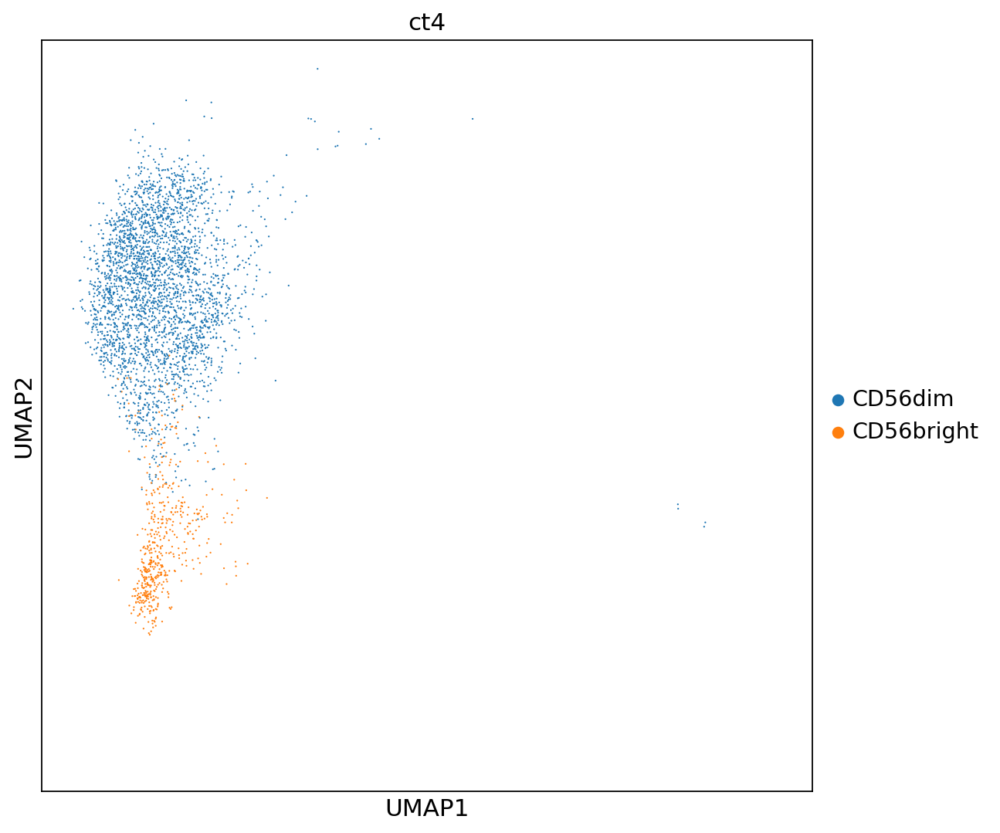

In [157]:
acg_umap(acg_subs['nk'],color='ct4')

#### CD3 Double-Negative

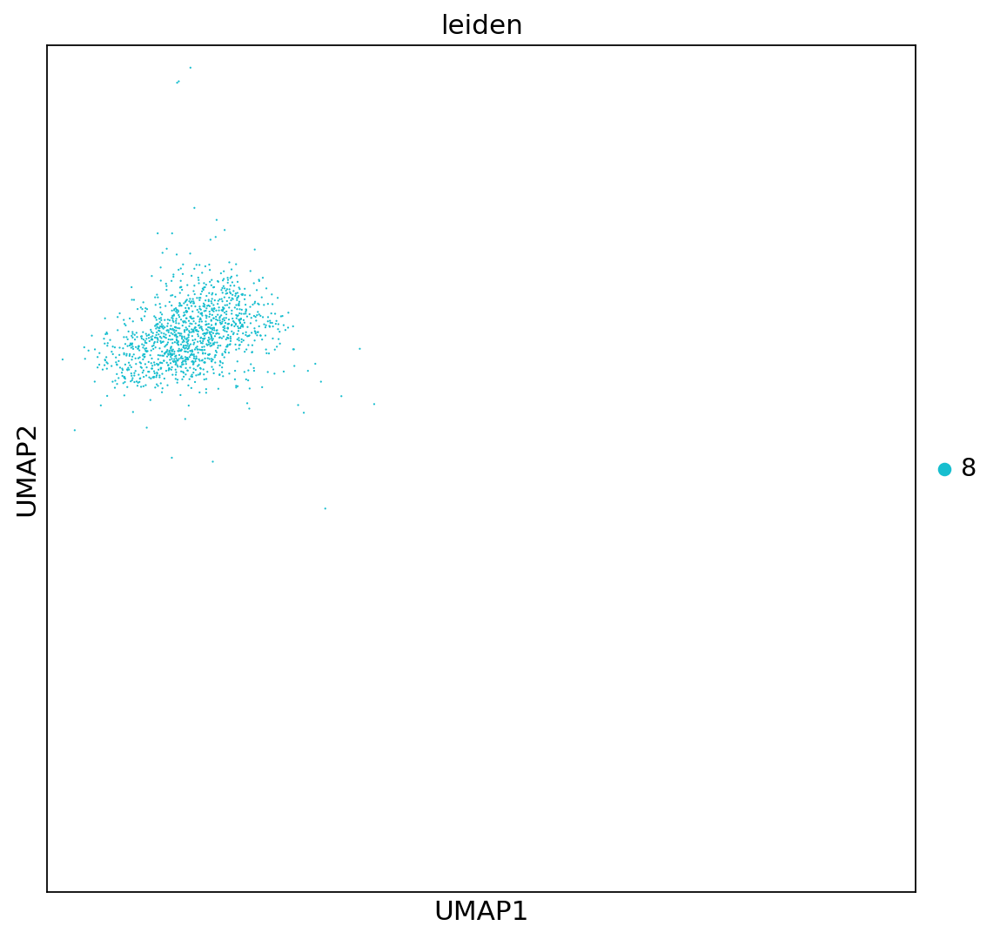

In [158]:
acg_umap(acg_subs['cd3dn'], color='leiden')

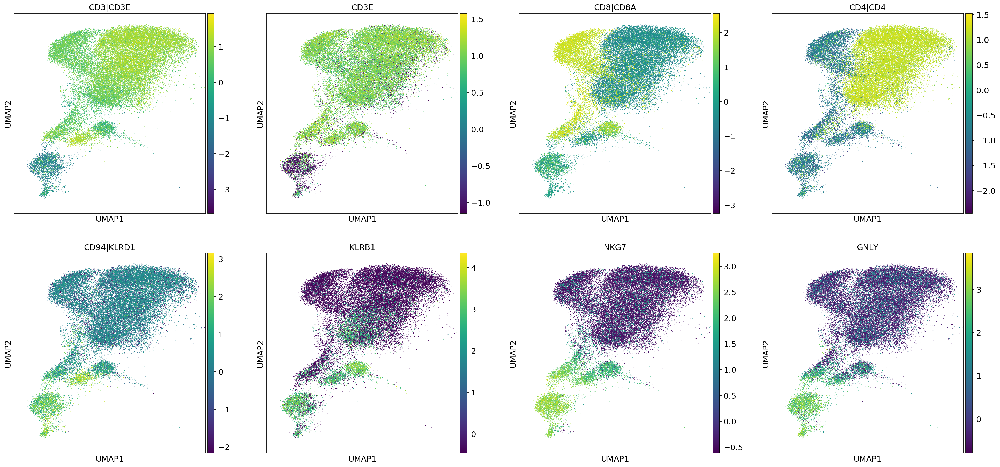

In [159]:
features = ['CD3|CD3E', 'CD3E', 'CD8|CD8A', 'CD4|CD4', 'CD94|KLRD1', 'KLRB1', 'NKG7', 'GNLY', 'GZMB']
fig, ax = plt.subplots(2, 4, figsize=(30,14))
for f, ax in tqdm(zip(features, np.ravel(ax))):
    acg_umap(acg,color=f, ax=ax)

In [160]:
ctdict = dict()
ctdict['NKT'] = [8]
acg_subs['cd3dn'].obs['ct4'] = acg_subs['cd3dn'].obs['leiden']
for ct in ctdict:
    for clust in ctdict[ct]:
        acg_subs['cd3dn'].obs['ct4'].replace(r'^%s$' % str(clust), ct, regex=True, inplace=True)
acg_subs['cd3dn'].obs['ct4'] = acg_subs['cd3dn'].obs['ct4'].astype('category')

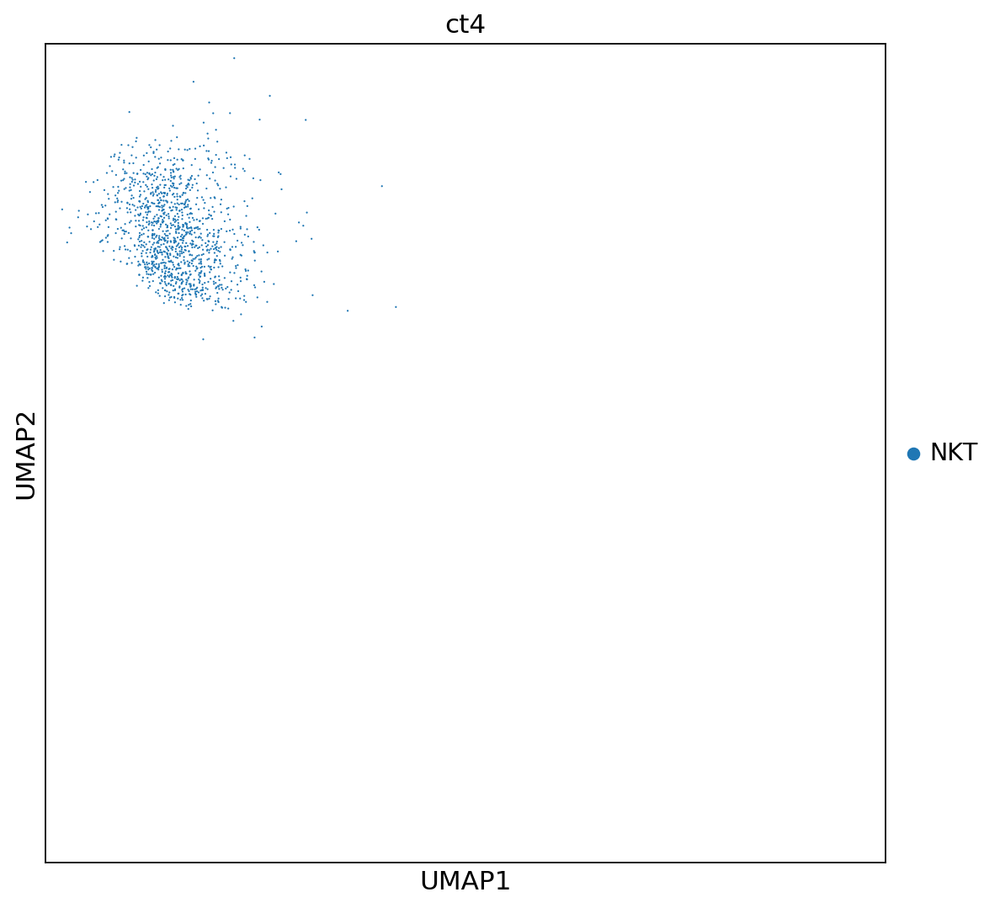

In [297]:
acg_umap(acg_subs['cd3dn'], color='ct4')

In [164]:
dict(zip(acg_subs.keys(), map(lambda x: acg_subs[x].obs['ct4'], acg_subs.keys())))

{'cd8': AAACCCAAGATGGCAC-0-0        Naive
 AAACCCAAGTGCGCTC-0-0        Naive
 AAACCCACAAAGGGTC-0-0        Naive
 AAACCCAGTCTGCCTT-0-0        Naive
 AAACCCAGTGGATCGA-0-0        Naive
                            ...   
 TTTGATCCAGGAAGTC-11-11      Naive
 TTTGATCTCCATATGG-11-11      Naive
 TTTGGAGCACGGTAGA-11-11      Naive
 TTTGGTTAGAAACACT-11-11      Naive
 TTTGTTGCAACTCGTA-11-11    Eff_Mem
 Name: ct4, Length: 13862, dtype: category
 Categories (3, object): [Naive, Mixed, Eff_Mem],
 'cd4': AAACCCAAGCGAATGC-0-0       EffM
 AAACCCAAGGCCGCTT-0-0      Naive
 AAACCCACATTCATCT-0-0       EffM
 AAACCCATCCTGGTCT-0-0       EffM
 AAACGAAAGTGCAAAT-0-0        Eff
                           ...  
 TTTGATCCACTGCACG-11-11    Naive
 TTTGATCTCGCCATAA-11-11    Naive
 TTTGGAGGTAGCGTTT-11-11    Naive
 TTTGGAGTCGCGTAGC-11-11    Naive
 TTTGTTGGTTAGGCTT-11-11    Naive
 Name: ct4, Length: 30804, dtype: category
 Categories (3, object): [Naive, EffM, Eff],
 'cd3dn': AAACGAAAGCCTGCCA-0-0      8
 AACAGGGAGAGGTTTA-0